## Обучение с далнейшей проверкой модели для сегментации частей кузова автомобиля

Для обучения модели, каждому участнику выпала одна модель машины. Мне попалась Lada Granta.

Для начала подготовил базу данных (изображения машины). После того как база собрана и рассортирована, подгоняем все изображения под один вид, также я сделал аугментацию заранее, чтобы увеличить кол-во изображений. Далее на Roboflow разметил 12 изображений и с помощью аугментации увеличил базу до 260 изображений.


## Приступим к обучению.

##Устанавливаем Ultralytics HUB и нужные библиотеки

In [30]:
!pip install ultralytics==8.0.196


import os
from IPython import display
display.clear_output()
import ultralytics
ultralytics.checks()
import glob
from ultralytics import YOLO
from IPython.display import display, Image

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.7/78.2 GB disk)


#Начинаем предобучение помощью Ultralytics HUB

In [ ]:
hub.login('8b3506a995c37755918ca3c16f17b371436162d555')

model = YOLO('https://hub.ultralytics.com/models/VrsuaUfmx302DtfuSaAg')
results = model.train()

requirements: Ultralytics requirement ['hub-sdk>=0.0.2'] not found, attempting AutoUpdate...

requirements: AutoUpdate success ✅ 13.4s, installed 1 package: ['hub-sdk>=0.0.2']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

Ultralytics HUB: New authentication successful ✅
Ultralytics HUB: View model at https://hub.ultralytics.com/models/VrsuaUfmx302DtfuSaAg 🚀


100%|██████████| 131M/131M [00:00<00:00, 157MB/s]


Ultralytics YOLOv8.1.10 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=https://app.roboflow.com/ds/4eIqev4gSM?key=VQKycueGVz, epochs=100, time=None, patience=100, batch=-1, imgsz=640, save=True, save_period=-1, cache=ram, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True

100%|██████████| 8.62M/8.62M [00:00<00:00, 27.1MB/s]
Unzipping 4eIqev4gSM to /content/datasets/4eIqev4gSM...: 100%|██████████| 172/172 [00:00<00:00, 4136.61file/s]


100%|██████████| 755k/755k [00:00<00:00, 21.8MB/s]


Overriding model.yaml nc=80 with nc=24

                   from  n    params  module                                       arguments                     
  0                  -1  1      2320  ultralytics.nn.modules.conv.Conv             [3, 80, 3, 2]                 
  1                  -1  1    115520  ultralytics.nn.modules.conv.Conv             [80, 160, 3, 2]               
  2                  -1  3    436800  ultralytics.nn.modules.block.C2f             [160, 160, 3, True]           
  3                  -1  1    461440  ultralytics.nn.modules.conv.Conv             [160, 320, 3, 2]              
  4                  -1  6   3281920  ultralytics.nn.modules.block.C2f             [320, 320, 6, True]           
  5                  -1  1   1844480  ultralytics.nn.modules.conv.Conv             [320, 640, 3, 2]              
  6                  -1  6  13117440  ultralytics.nn.modules.block.C2f             [640, 640, 6, True]           
  7                  -1  1   3687680  ultralytic

100%|██████████| 6.23M/6.23M [00:00<00:00, 112MB/s]


AMP: checks passed ✅
AutoBatch: Computing optimal batch size for imgsz=640
AutoBatch: CUDA:0 (Tesla T4) 14.75G total, 0.57G reserved, 0.55G allocated, 13.63G free
      Params      GFLOPs  GPU_mem (GB)  forward (ms) backward (ms)                   input                  output
    68175720       258.2         1.487         69.77         179.1        (1, 3, 640, 640)                    list
    68175720       516.5         2.231         52.21         78.67        (2, 3, 640, 640)                    list
    68175720        1033         3.823          91.5         117.4        (4, 3, 640, 640)                    list
    68175720        2066         6.740         190.5         200.5        (8, 3, 640, 640)                    list
    68175720        4132        12.824         358.1         397.4       (16, 3, 640, 640)                    list
AutoBatch: Using batch-size 9 for CUDA:0 8.65G/14.75G (59%) ✅


train: Scanning /content/datasets/4eIqev4gSM/train/labels... 78 images, 0 backgrounds, 0 corrupt: 100%|██████████| 78/78 [00:00<00:00, 785.78it/s]

train: WARNING ⚠️ /content/datasets/4eIqev4gSM/train/images/101_png_jpg.rf.44aa3d69f7fcccd66977ae116649fb5e.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/datasets/4eIqev4gSM/train/images/101_png_jpg.rf.4af56c903505187458483a6e59dbee9c.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/datasets/4eIqev4gSM/train/images/101_png_jpg.rf.51452533cc6c961d3a4497d3114e02a9.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/datasets/4eIqev4gSM/train/images/101_png_jpg.rf.6b531ce647c6579be92163c0a0b4ec0c.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/datasets/4eIqev4gSM/train/images/101_png_jpg.rf.c41bc5050bb386b127a910e2e8c2e753.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/datasets/4eIqev4gSM/train/images/101_png_jpg.rf.dd2795e820d7c5ddd770970c3ad6cdc2.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/datasets/4eIqev4gSM/train/images/107_png_jpg.rf.0a5658283021495133466275769f2f13.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /c


train: Caching images (0.1GB ram): 100%|██████████| 78/78 [00:00<00:00, 151.13it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/datasets/4eIqev4gSM/valid/labels... 1 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1/1 [00:00<00:00, 86.80it/s]

val: New cache created: /content/datasets/4eIqev4gSM/valid/labels.cache



val: Caching images (0.0GB ram): 100%|██████████| 1/1 [00:00<00:00, 119.15it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000357, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0004921875), 103 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      7.98G      2.064        4.7      2.015        205        640: 100%|██████████| 9/9 [00:16<00:00,  1.83s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.55s/it]

                   all          1         27      0.639      0.205      0.177     0.0998



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      8.73G      1.519      2.665      1.529        235        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.29it/s]

                   all          1         27      0.435      0.543      0.545      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      8.75G      1.309      1.535      1.336        310        640: 100%|██████████| 9/9 [00:06<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.05it/s]

                   all          1         27      0.581      0.587      0.678       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      8.73G      1.152      1.105      1.234        321        640: 100%|██████████| 9/9 [00:06<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.82it/s]


                   all          1         27      0.706      0.776      0.815      0.665

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100       8.8G      1.145     0.9339      1.193        295        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.88it/s]


                   all          1         27      0.661      0.883      0.881      0.701

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100       8.8G      1.001     0.8063      1.136        282        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.73it/s]

                   all          1         27      0.773      0.856      0.908      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100       8.7G      1.035     0.7659      1.157        221        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.05it/s]

                   all          1         27      0.859      0.739      0.881      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      8.71G      1.013     0.7443      1.121        399        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.66it/s]


                   all          1         27      0.774       0.87      0.952      0.691

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      8.78G     0.9877     0.7261      1.104        363        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.11it/s]


                   all          1         27       0.85      0.841      0.902       0.65

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      8.69G       1.06     0.7497      1.189        246        640: 100%|██████████| 9/9 [00:06<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.28it/s]


                   all          1         27      0.869       0.87      0.928        0.7

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      8.67G     0.9952     0.7521      1.134        299        640: 100%|██████████| 9/9 [00:06<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.90it/s]


                   all          1         27      0.896      0.826      0.928      0.704

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      8.75G      1.019     0.6917      1.149        234        640: 100%|██████████| 9/9 [00:06<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.37it/s]


                   all          1         27      0.733       0.87      0.919      0.672

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      8.81G      1.037     0.6929      1.152        247        640: 100%|██████████| 9/9 [00:06<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 14.11it/s]


                   all          1         27      0.787      0.863      0.952       0.69

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      8.64G       1.01     0.6755      1.145        410        640: 100%|██████████| 9/9 [00:06<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.32it/s]


                   all          1         27      0.882      0.866      0.952      0.692

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      8.81G     0.9211     0.6164      1.077        268        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.01it/s]

                   all          1         27      0.856      0.913      0.952      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      8.73G     0.9098     0.6293      1.048        426        640: 100%|██████████| 9/9 [00:06<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.66it/s]


                   all          1         27      0.831      0.902      0.952      0.719

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      8.79G     0.9012     0.6291      1.061        204        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.00it/s]


                   all          1         27      0.765      0.891      0.944      0.705

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      8.82G     0.8993     0.6022      1.065        289        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.59it/s]

                   all          1         27      0.819      0.907      0.952      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      8.81G     0.9113      0.595      1.065        161        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.02it/s]


                   all          1         27      0.851      0.893      0.959      0.714

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      8.71G     0.8624     0.5595      1.052        250        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all          1         27      0.931      0.761      0.943      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      8.81G     0.8516     0.5704      1.049        303        640: 100%|██████████| 9/9 [00:06<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.57it/s]

                   all          1         27      0.876      0.848      0.939      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      8.72G      0.814      0.529      1.007        317        640: 100%|██████████| 9/9 [00:06<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]

                   all          1         27        0.9      0.804      0.944       0.75



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      8.82G     0.7714      0.521     0.9882        206        640: 100%|██████████| 9/9 [00:06<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.81it/s]


                   all          1         27        0.9      0.761      0.944      0.729

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      8.74G     0.8264     0.5481       1.02        280        640: 100%|██████████| 9/9 [00:06<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.87it/s]


                   all          1         27      0.898      0.831      0.905       0.71

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100       8.8G     0.7893      0.514      1.009        213        640: 100%|██████████| 9/9 [00:06<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.31it/s]


                   all          1         27      0.921      0.833      0.902      0.727

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      8.76G     0.8394      0.533      1.042        242        640: 100%|██████████| 9/9 [00:06<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.37it/s]


                   all          1         27      0.897      0.843      0.923      0.733

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      8.81G     0.7799     0.5173      0.993        275        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.83it/s]

                   all          1         27      0.893      0.833      0.944      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      8.76G     0.8098     0.5018       1.01        277        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.06it/s]

                   all          1         27      0.764      0.948      0.952      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      8.78G     0.7623      0.495     0.9971        293        640: 100%|██████████| 9/9 [00:06<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.49it/s]

                   all          1         27      0.874      0.839      0.952      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      8.75G     0.7166     0.4634      0.978        301        640: 100%|██████████| 9/9 [00:06<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.40it/s]

                   all          1         27      0.873      0.848      0.952       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      8.69G     0.7857     0.4975     0.9988        289        640: 100%|██████████| 9/9 [00:06<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.15it/s]


                   all          1         27      0.839      0.855      0.952      0.702

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      8.72G     0.7332     0.4759     0.9879        198        640: 100%|██████████| 9/9 [00:06<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.93it/s]


                   all          1         27      0.747      0.875      0.937      0.751

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      8.73G     0.7675     0.4822      1.004        248        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.44it/s]


                   all          1         27      0.865      0.804      0.941      0.753

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      8.76G     0.7611     0.4725     0.9836        178        640: 100%|██████████| 9/9 [00:06<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.99it/s]


                   all          1         27      0.896       0.81      0.952      0.727

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      8.81G      0.708     0.4505     0.9518        303        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.96it/s]

                   all          1         27      0.892      0.843      0.952      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      8.77G     0.7025     0.4447     0.9652        196        640: 100%|██████████| 9/9 [00:06<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.58it/s]


                   all          1         27      0.874      0.856      0.952      0.725

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      8.73G     0.7046     0.4509     0.9669        227        640: 100%|██████████| 9/9 [00:06<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.14it/s]


                   all          1         27      0.928      0.793      0.952       0.73

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      8.75G      0.706     0.4494     0.9638        304        640: 100%|██████████| 9/9 [00:06<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.72it/s]


                   all          1         27      0.802      0.856      0.952      0.751

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      8.72G     0.6852     0.4441     0.9621        258        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.12it/s]

                   all          1         27      0.858      0.798      0.952      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      8.81G     0.6391     0.4133     0.9254        250        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.72it/s]


                   all          1         27      0.932      0.766      0.952      0.732

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      8.74G     0.6942      0.438       0.97        158        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.03it/s]

                   all          1         27      0.934      0.804      0.904      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      8.82G     0.7063     0.4514     0.9635        209        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.30it/s]


                   all          1         27      0.905      0.804      0.923      0.735

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      8.72G     0.6304     0.4077     0.9315        254        640: 100%|██████████| 9/9 [00:06<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.09it/s]


                   all          1         27      0.891      0.809      0.952      0.717

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      8.82G     0.6561     0.4152     0.9278        245        640: 100%|██████████| 9/9 [00:06<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.26it/s]


                   all          1         27      0.893      0.809      0.923      0.706

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100       8.8G     0.6701     0.4149     0.9333        202        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.43it/s]


                   all          1         27      0.732      0.911      0.919      0.688

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      8.77G     0.6272     0.4025     0.9262        260        640: 100%|██████████| 9/9 [00:06<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.87it/s]


                   all          1         27      0.736      0.909      0.917      0.698

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      8.69G     0.6264     0.4071     0.9407        247        640: 100%|██████████| 9/9 [00:06<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.59it/s]


                   all          1         27       0.88      0.803      0.944       0.72

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      8.73G     0.6296     0.3973      0.923        300        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.43it/s]


                   all          1         27      0.901      0.761      0.941      0.716

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      8.79G     0.5889      0.381     0.9026        191        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all          1         27      0.872      0.804      0.936      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      8.66G     0.6134     0.3951     0.9293        326        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.08it/s]


                   all          1         27      0.824      0.848      0.936      0.719

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      8.75G     0.5967     0.3886     0.9113        348        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.36it/s]

                   all          1         27      0.953      0.788      0.935      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100       8.7G     0.6062     0.3877      0.917        291        640: 100%|██████████| 9/9 [00:06<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.66it/s]

                   all          1         27      0.908       0.84      0.944      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100       8.7G     0.6146     0.3899     0.9186        260        640: 100%|██████████| 9/9 [00:06<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.16it/s]

                   all          1         27      0.881      0.903      0.952      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      8.73G     0.6048     0.3792     0.9169        210        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.23it/s]

                   all          1         27      0.904      0.898      0.952      0.747



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      8.82G     0.5898     0.3809     0.9056        308        640: 100%|██████████| 9/9 [00:06<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.09it/s]


                   all          1         27      0.898        0.9      0.952      0.741

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      8.81G     0.5604     0.3587     0.8996        238        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.46it/s]


                   all          1         27      0.884      0.903      0.952      0.727

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100       8.8G     0.5595     0.3575     0.9013        238        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.65it/s]

                   all          1         27      0.845      0.891      0.944      0.757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      8.79G      0.551     0.3624       0.91        238        640: 100%|██████████| 9/9 [00:06<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.63it/s]


                   all          1         27      0.847      0.891      0.944       0.76

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      8.76G     0.5591     0.3553     0.8986        290        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.84it/s]

                   all          1         27      0.808      0.894      0.944      0.762



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      8.73G     0.5505     0.3557     0.9062        255        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.98it/s]


                   all          1         27      0.884      0.848      0.944      0.756

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100       8.8G     0.5406     0.3502     0.9023        263        640: 100%|██████████| 9/9 [00:06<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.08it/s]

                   all          1         27      0.909      0.848      0.944       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      8.77G     0.5443     0.3497     0.9048        181        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.75it/s]

                   all          1         27      0.922      0.848      0.944        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      8.76G     0.5366     0.3432      0.894        245        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.87it/s]


                   all          1         27      0.892      0.848      0.944      0.784

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      8.69G     0.5213     0.3349     0.9002        199        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.82it/s]

                   all          1         27        0.8      0.891      0.944       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      8.81G     0.5489     0.3379     0.8996        253        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.38it/s]

                   all          1         27      0.819      0.891      0.944      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      8.82G     0.5176     0.3392     0.8726        242        640: 100%|██████████| 9/9 [00:06<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.26it/s]


                   all          1         27      0.854      0.865      0.952       0.76

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      8.81G     0.5469     0.3444     0.9021        258        640: 100%|██████████| 9/9 [00:06<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.54it/s]

                   all          1         27       0.86      0.864      0.952      0.754



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      8.81G     0.5227     0.3309     0.8856        202        640: 100%|██████████| 9/9 [00:06<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.75it/s]


                   all          1         27      0.857      0.864      0.952      0.749
Ultralytics HUB: Uploading checkpoint https://hub.ultralytics.com/models/VrsuaUfmx302DtfuSaAg

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      8.69G     0.4973     0.3252     0.8911        278        640: 100%|██████████| 9/9 [00:07<00:00,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.75it/s]


                   all          1         27      0.856      0.848      0.944      0.742

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      8.81G     0.4837     0.3212      0.872        150        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.12it/s]

                   all          1         27      0.877      0.848      0.944      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      8.79G     0.4868     0.3191     0.8747        342        640: 100%|██████████| 9/9 [00:06<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.22it/s]


                   all          1         27      0.907      0.848      0.944      0.735

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      8.77G      0.495     0.3199     0.8852        270        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.49it/s]


                   all          1         27      0.924      0.845      0.944      0.744

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      8.73G     0.4798     0.3188     0.8767        211        640: 100%|██████████| 9/9 [00:06<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.81it/s]


                   all          1         27      0.951      0.835      0.944      0.745

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      8.78G     0.4906     0.3211     0.8755        277        640: 100%|██████████| 9/9 [00:06<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.72it/s]

                   all          1         27      0.953      0.833      0.944      0.745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      8.73G     0.5064     0.3253      0.881        297        640: 100%|██████████| 9/9 [00:06<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.68it/s]

                   all          1         27      0.946      0.833      0.944      0.747



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      8.79G     0.4916     0.3196     0.8692        262        640: 100%|██████████| 9/9 [00:07<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.69it/s]

                   all          1         27      0.924      0.835      0.944      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      8.67G     0.4583     0.3041     0.8702        209        640: 100%|██████████| 9/9 [00:08<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.62it/s]


                   all          1         27      0.921      0.836      0.944      0.744

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100       8.8G     0.4904     0.3205     0.8754        184        640: 100%|██████████| 9/9 [00:06<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.58it/s]

                   all          1         27      0.918      0.838      0.944      0.753



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      8.79G     0.5071     0.3157     0.8756        367        640: 100%|██████████| 9/9 [00:06<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.14it/s]


                   all          1         27      0.926      0.848      0.952       0.75

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      8.75G     0.4813     0.3102     0.8872        228        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.42it/s]


                   all          1         27      0.927      0.848      0.941      0.739

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      8.82G     0.4808     0.3112     0.8783        266        640: 100%|██████████| 9/9 [00:06<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.50it/s]

                   all          1         27      0.931      0.848      0.944      0.755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      8.77G      0.462     0.2957     0.8599        311        640: 100%|██████████| 9/9 [00:06<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.94it/s]

                   all          1         27      0.934      0.848      0.944       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100       8.7G     0.4655     0.2975     0.8819        211        640: 100%|██████████| 9/9 [00:06<00:00,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 13.37it/s]

                   all          1         27      0.949      0.855      0.952       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      8.77G     0.4453     0.2897     0.8579        365        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.41it/s]


                   all          1         27      0.946      0.846      0.944      0.767

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      8.81G     0.4422     0.2946     0.8661        212        640: 100%|██████████| 9/9 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.00it/s]

                   all          1         27       0.95      0.852      0.952      0.753



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      8.79G     0.4431     0.2883     0.8614        249        640: 100%|██████████| 9/9 [00:06<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.84it/s]

                   all          1         27      0.943      0.856      0.952      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      8.73G     0.4626     0.2979     0.8719        230        640: 100%|██████████| 9/9 [00:06<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all          1         27      0.929      0.858      0.952      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      8.72G     0.4539     0.2928     0.8683        160        640: 100%|██████████| 9/9 [00:06<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.29it/s]


                   all          1         27      0.926      0.858      0.952      0.739

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100       8.8G     0.4182     0.2788     0.8528        293        640: 100%|██████████| 9/9 [00:06<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 12.28it/s]


                   all          1         27      0.913      0.858      0.952       0.75

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      8.77G     0.4221     0.2762     0.8549        241        640: 100%|██████████| 9/9 [00:06<00:00,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.93it/s]


                   all          1         27      0.899      0.859      0.952      0.762
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      8.67G     0.3908      0.258     0.8487        159        640: 100%|██████████| 9/9 [00:10<00:00,  1.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 17.48it/s]

                   all          1         27      0.906      0.858      0.952      0.759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      8.64G     0.3691     0.2472     0.8261        162        640: 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.11it/s]


                   all          1         27      0.914      0.857      0.952      0.749

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      8.64G     0.3863     0.2563     0.8447        162        640: 100%|██████████| 9/9 [00:10<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 18.00it/s]

                   all          1         27      0.922      0.856      0.952      0.762



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      8.65G     0.3734     0.2498     0.8209        169        640: 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.69it/s]


                   all          1         27      0.925      0.855      0.952      0.767

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      8.67G     0.3666     0.2467     0.8283        169        640: 100%|██████████| 9/9 [00:06<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.71it/s]

                   all          1         27      0.927      0.855      0.952      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      8.65G     0.3708     0.2461     0.8353        166        640: 100%|██████████| 9/9 [00:06<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 16.02it/s]

                   all          1         27      0.931      0.855      0.952      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      8.66G     0.3807     0.2506      0.835        167        640: 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.77it/s]


                   all          1         27      0.938      0.854      0.952      0.772

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      8.66G     0.3558     0.2445     0.8284        156        640: 100%|██████████| 9/9 [00:06<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  9.99it/s]

                   all          1         27      0.942      0.854      0.952      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      8.64G     0.3623     0.2465     0.8404        170        640: 100%|██████████| 9/9 [00:06<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.44it/s]

                   all          1         27      0.946      0.854      0.952      0.773



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      8.65G     0.3544     0.2392     0.8274        164        640: 100%|██████████| 9/9 [00:06<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 19.75it/s]

                   all          1         27      0.947      0.854      0.952      0.772


# Подготавливаемся к обучению

In [31]:
HOME = os.getcwd() #Создаем переменну для каталога
print(HOME) #Проверяем текущий каталог

/content


# Устанавливаем Roboflow и через API берем ранее подготовленную базу данных

In [4]:
!mkdir {HOME}/datasets
%cd {HOME}/datasets

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="sQHgfoGU7PieZViJKMn9")
project = rf.workspace("project-fmzrr").project("cars_body_parts")
dataset = project.version(3).download("yolov8")

/content/datasets
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.2/70.2 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 13.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 21.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 14.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.7/86.7 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.2 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.6
    Uninstalling idna-3.6:
      Successfully uninstalled idna-3.6
  Attempting uninstall: cycler
    Found existing in

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to cars_body_parts-3 in yolov8:: 100%|██████████| 532/532 [00:00<00:00, 5658.18it/s]


# Основное обучение.

In [5]:
%cd {HOME}
!yolo task=segment mode=train model=yolov8n-seg.pt  data={dataset.location}/data.yaml epochs=70 imgsz=640


/content
100% 6.73M/6.73M [00:00<00:00, 115MB/s]
New https://pypi.org/project/ultralytics/8.1.10 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=segment, mode=train, model=yolov8n-seg.pt, data=/content/datasets/cars_body_parts-3/data.yaml, epochs=70, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, 

In [6]:
%cd {HOME}
!yolo task=segment mode=train model=yolov8s-seg.pt  data={dataset.location}/data.yaml batch=8 epochs=50 imgsz=640

/content
100% 22.8M/22.8M [00:00<00:00, 251MB/s]
New https://pypi.org/project/ultralytics/8.1.10 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=segment, mode=train, model=yolov8s-seg.pt, data=/content/datasets/cars_body_parts-3/data.yaml, epochs=50, patience=50, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, s

# Проводим проверки точности обучения.

/content


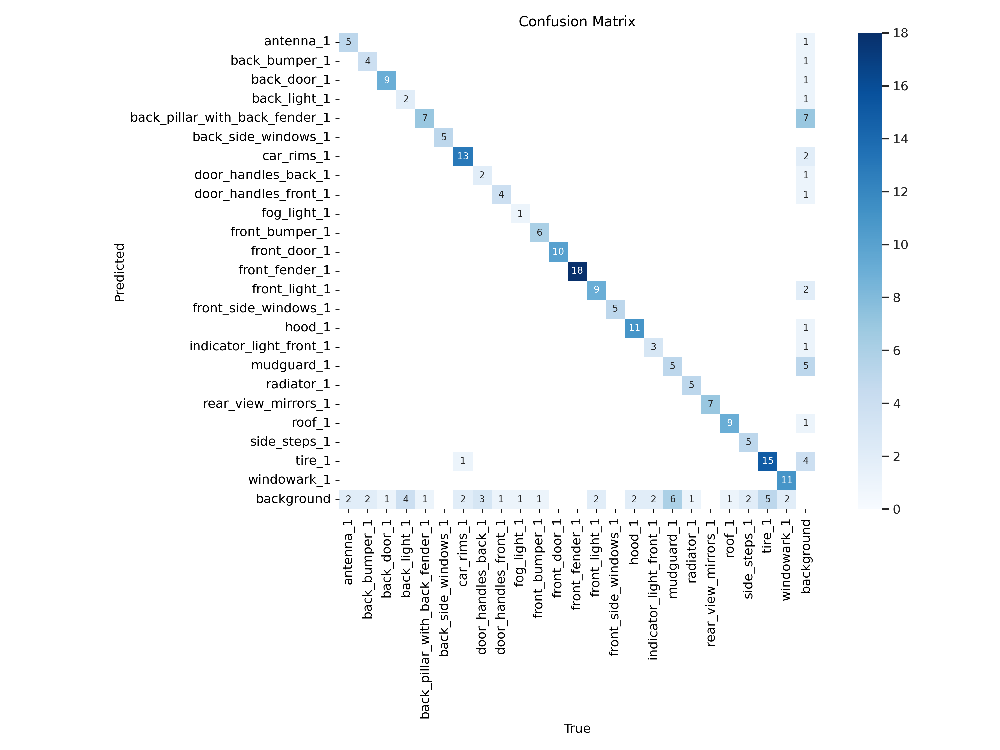

In [33]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train2/confusion_matrix.png', width=1000)

/content


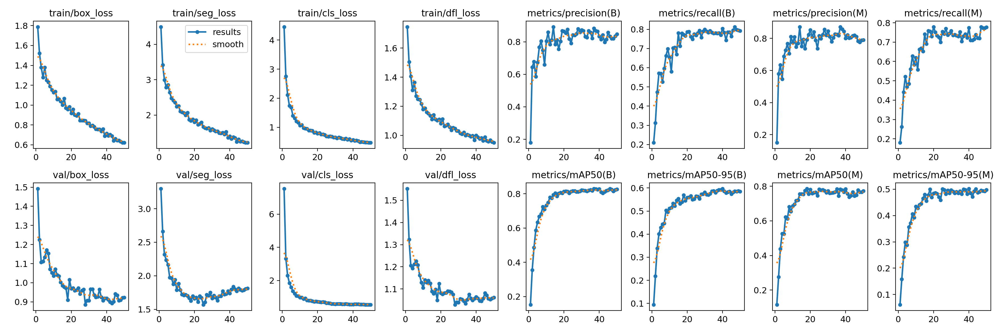

In [34]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train2/results.png', width=1000)

# Проверяем наглядко, как прошла сегментация.

/content


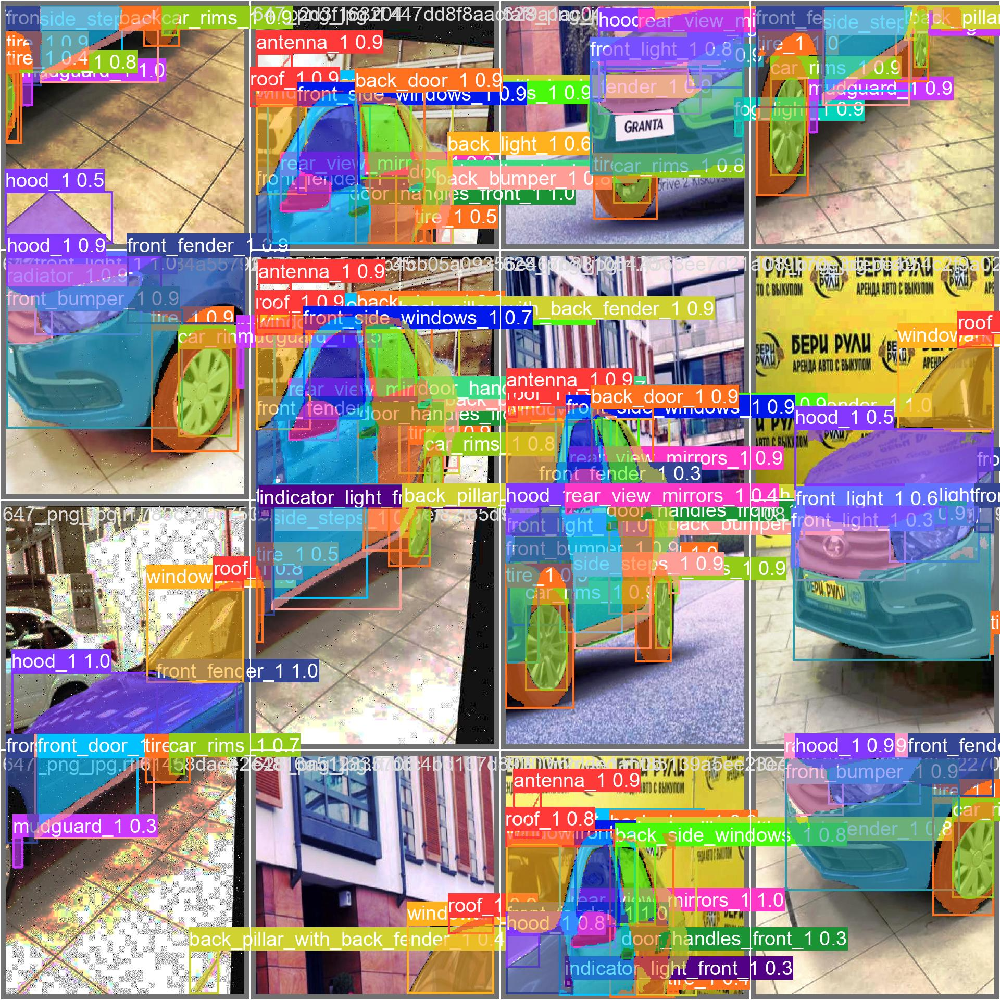

In [35]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train2/val_batch0_pred.jpg', width=1000)

# Проверяем результаты.

# Валидационная выборка

In [36]:
%cd {HOME}

!yolo task=segment mode=val model={HOME}/runs/segment/train2/weights/best.pt data={dataset.location}/data.yaml plots=true batch=4

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11788888 parameters, 0 gradients, 42.5 GFLOPs
val: Scanning /content/datasets/cars_body_parts-3/valid/labels.cache... 20 images, 0 backgrounds, 0 corrupt: 100% 20/20 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/datasets/cars_body_parts-3/valid/images/107_png_jpg.rf.64563eb942539c2b5ea3d316472857b9.jpg: 1 duplicate labels removed
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 5/5 [00:03<00:00,  1.61it/s]
                   all         20        213      0.833      0.804      0.828      0.597      0.801      0.774      0.784        0.5
             antenna_1         20          7      0.774      0.714      0.721      0.566      0.618      0.571      0.467       0.16
         back_bumper_1         20          6      0.703      0.667      0.882       0.35      0.702 

# Проверяем наглядно как отработала на валидационной выборке.

/content


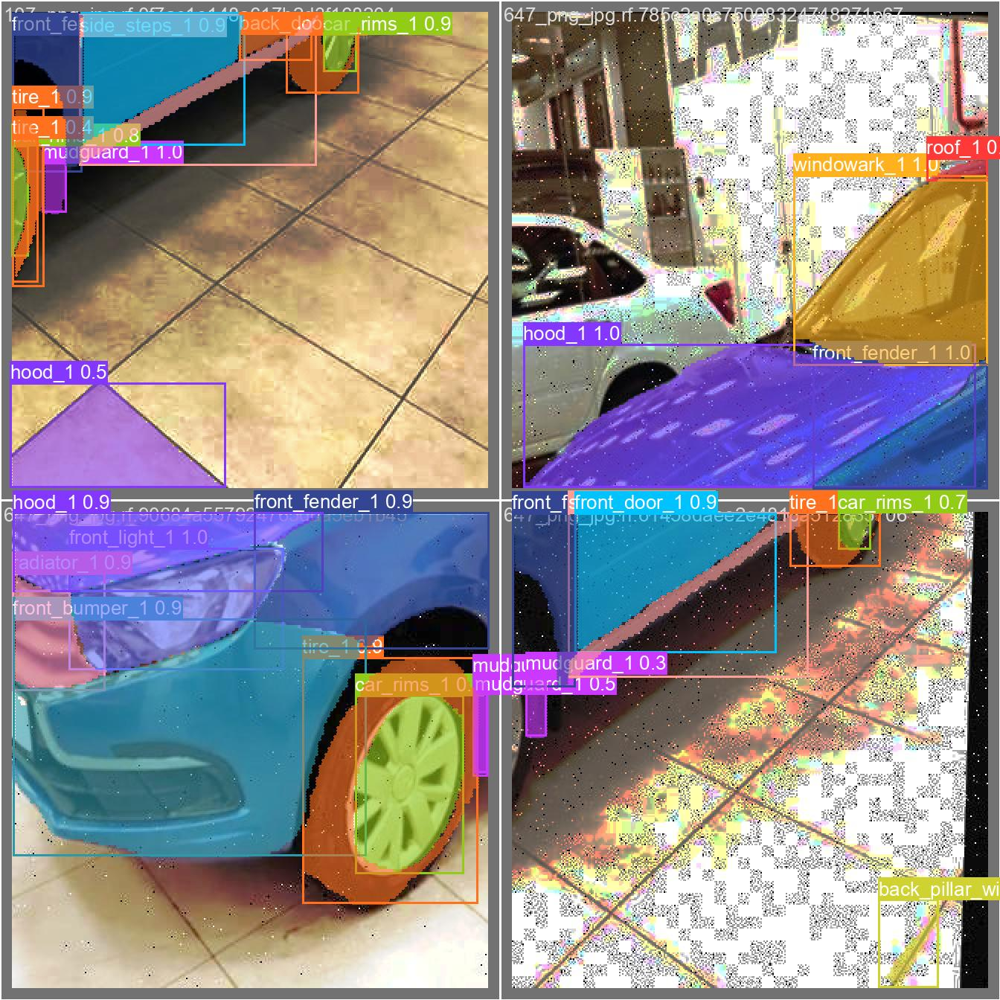

In [37]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/val2/val_batch0_pred.jpg', width=1000)

#Тестовая выборка

In [38]:
%cd {HOME}
!yolo task=segment mode=predict model={HOME}/runs/segment/train2/weights/best.pt conf=0.25 source={dataset.location}/test/images save=True boxes=false show=true


/content
WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11788888 parameters, 0 gradients, 42.5 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.0eafcc35c8253a877822a98fd15a4807.jpg: 640x640 1 car_rims_1, 1 front_bumper_1, 1 front_fender_1, 2 front_light_1s, 1 hood_1, 1 mudguard_1, 1 radiator_1, 2 tire_1s, 21.3ms
image 2/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.4ad92e1ddf9844ff11b3576fbe6ef59f.jpg: 640x640 1 back_door_1, 2 back_pillar_with_back_fender_1s, 1 car_rims_1, 1 front_door_1, 1 side_steps_1, 1 tire_1, 21.0ms
image 3/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.717769fa757d34d9d573943d391f93b9.jpg: 640x640 1 antenna_1, 2 front_fender_1s, 1 front_light_1, 1 hood_1, 1 roof_1, 1 windowark_1, 20.9ms
image 4/20 

# Проверяем наглядно, как отработала на тестовой выборке сегментация.

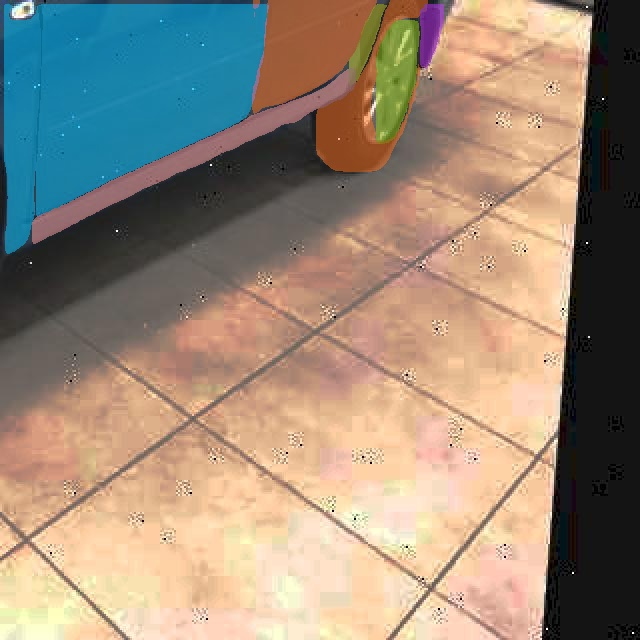

/content/runs/segment/predict3/107_png_jpg.rf.f081d6e853c2cd1d7a2031a07dc4ccaf.jpg


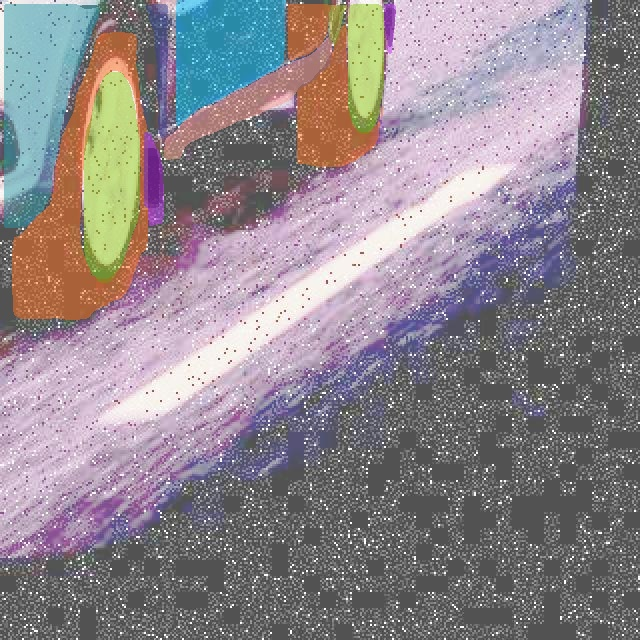

/content/runs/segment/predict3/631_png_jpg.rf.ec38ad2fc8f42ba927b6d9ad0c55bb62.jpg


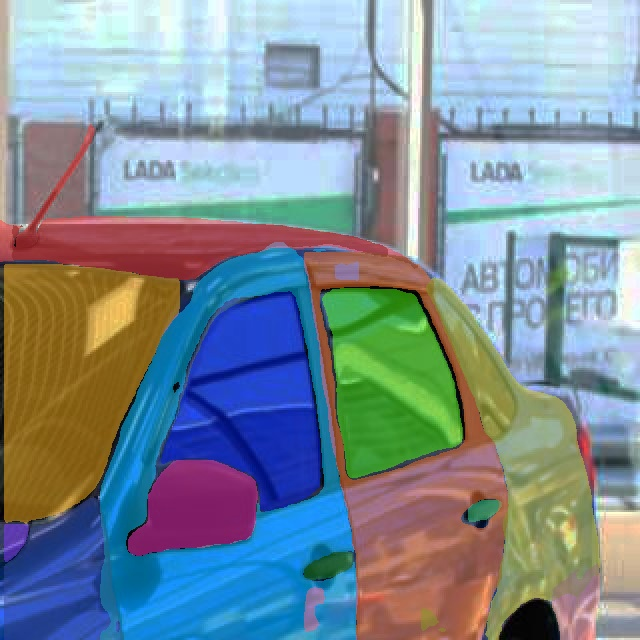

/content/runs/segment/predict3/105_png_jpg.rf.636bc47b317f85cde1031350cbe87e2f.jpg


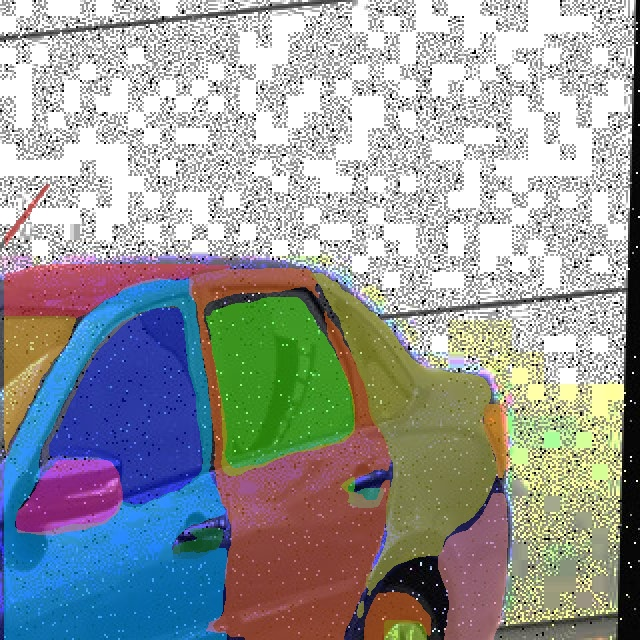

/content/runs/segment/predict3/100_png_jpg.rf.9340cb2e6f9e1001e937267adf6c2a4a.jpg


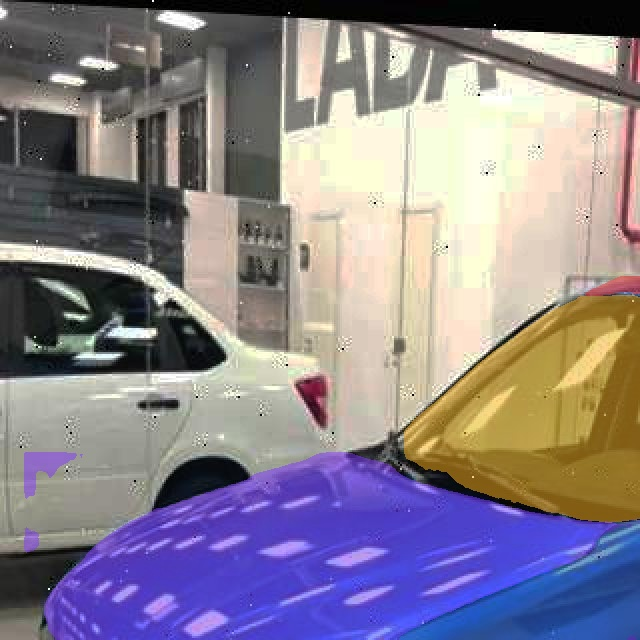

/content/runs/segment/predict3/107_png_jpg.rf.b8fbc3e4a81da35a316eade850fed3d2.jpg


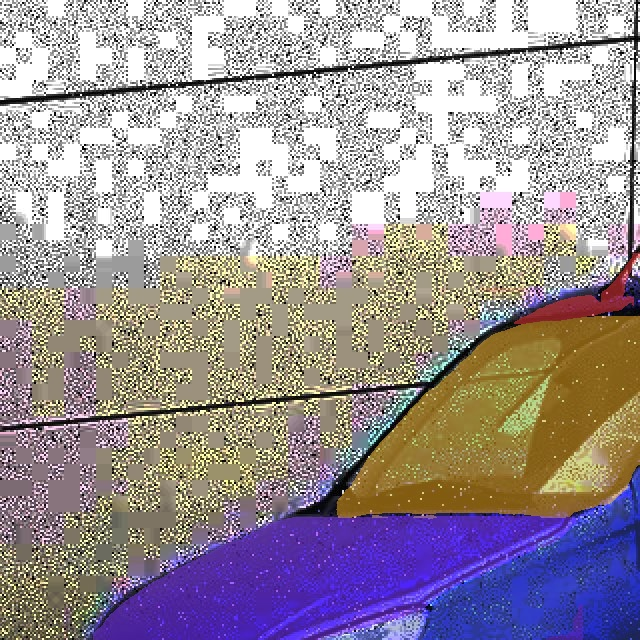

/content/runs/segment/predict3/100_png_jpg.rf.717769fa757d34d9d573943d391f93b9.jpg


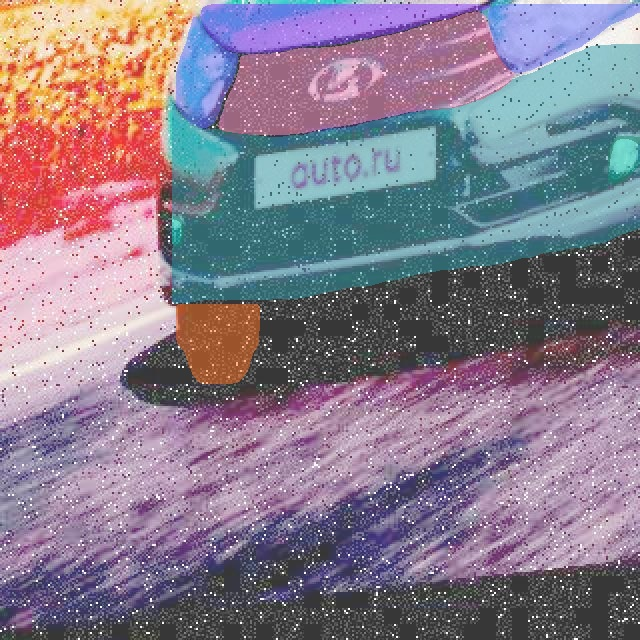

/content/runs/segment/predict3/631_png_jpg.rf.14feee61d3c2b8db5627d2e8dcef31b5.jpg


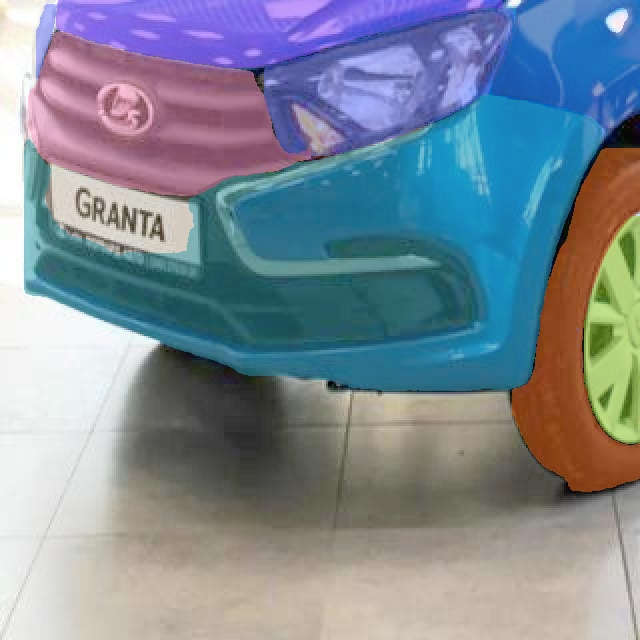

/content/runs/segment/predict3/105_png_jpg.rf.35f0c9ab2810c9e543f76eee6a449f82.jpg


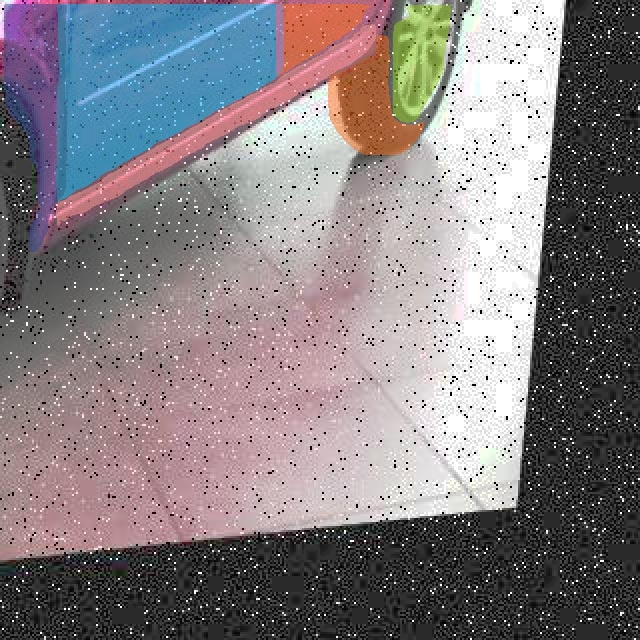

/content/runs/segment/predict3/101_png_jpg.rf.1e0365e81bf956570dff206877257ae9.jpg


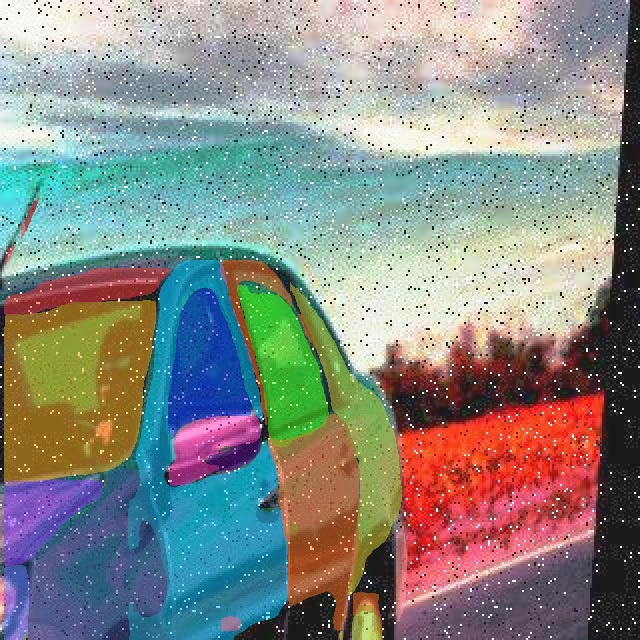

/content/runs/segment/predict3/631_png_jpg.rf.8329fc1ce5e4fec8eed0f9f8b419de63.jpg


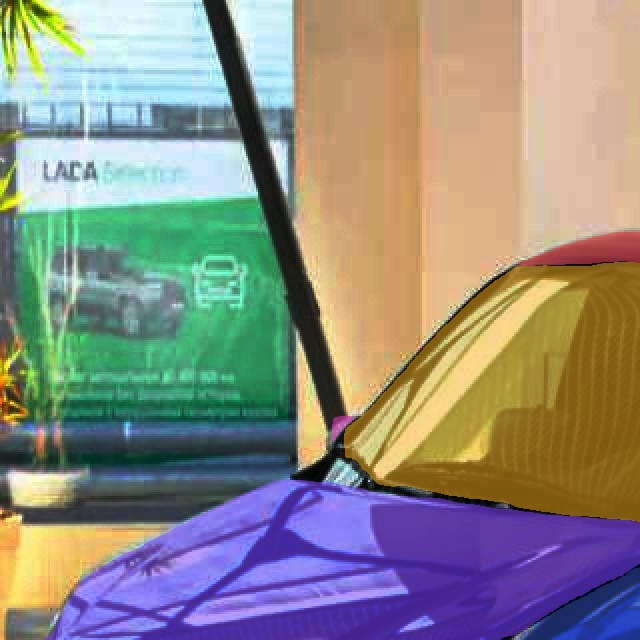

/content/runs/segment/predict3/105_png_jpg.rf.d8f5fbbb48804190177cd83bb3bc5a5f.jpg


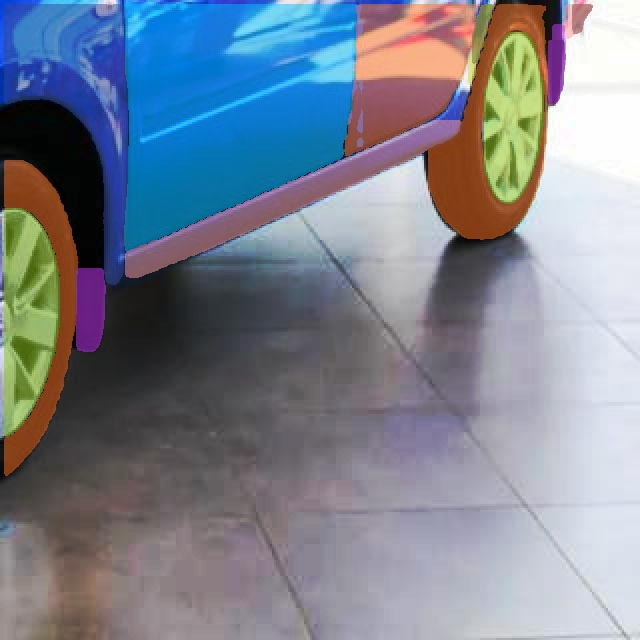

/content/runs/segment/predict3/105_png_jpg.rf.bf96d3d0fcad6e1943299028a7fd4c53.jpg


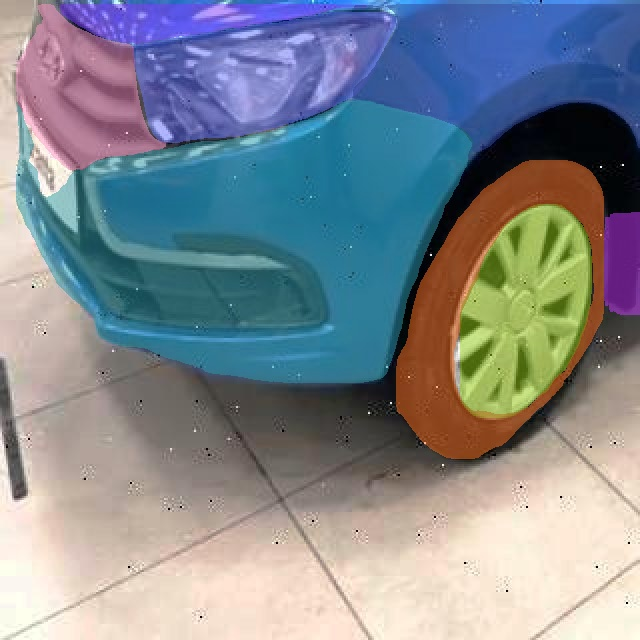

/content/runs/segment/predict3/107_png_jpg.rf.acbad7e6e1f894d1f438211eb84e4279.jpg


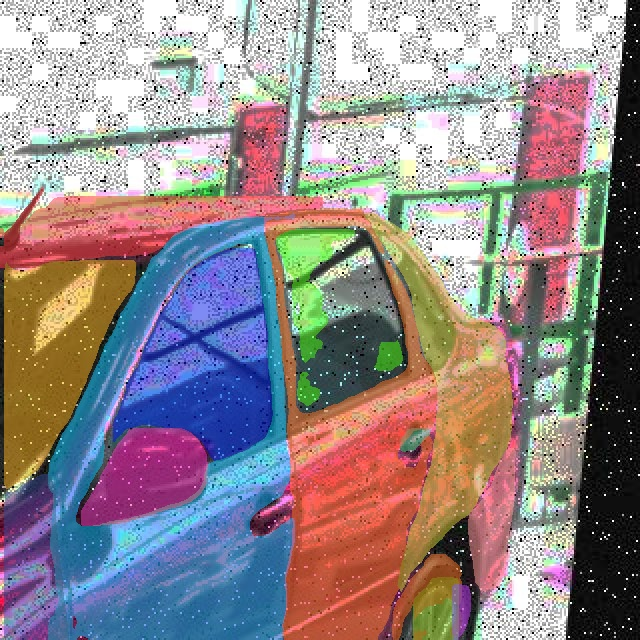

/content/runs/segment/predict3/101_png_jpg.rf.60b015b42aad6e032f6d9579ed66cf69.jpg


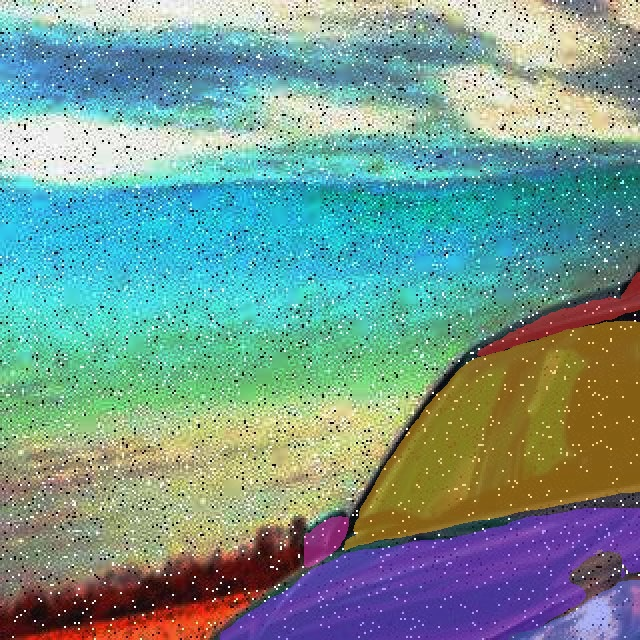

/content/runs/segment/predict3/631_png_jpg.rf.3e554104de97e8478e298495b8101520.jpg


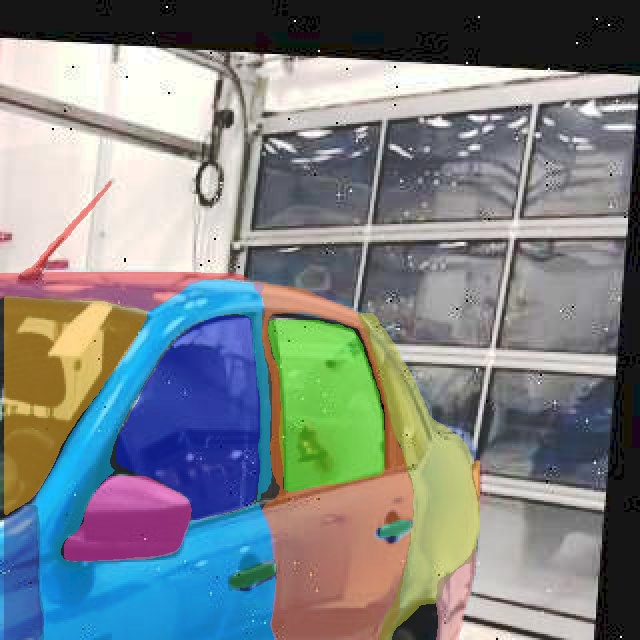

/content/runs/segment/predict3/107_png_jpg.rf.e547a201e6971528d612074b94beb62d.jpg


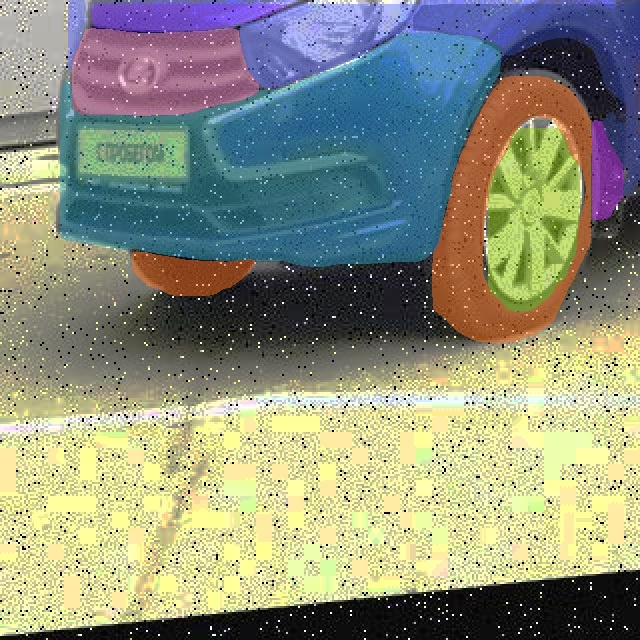

/content/runs/segment/predict3/100_png_jpg.rf.0eafcc35c8253a877822a98fd15a4807.jpg


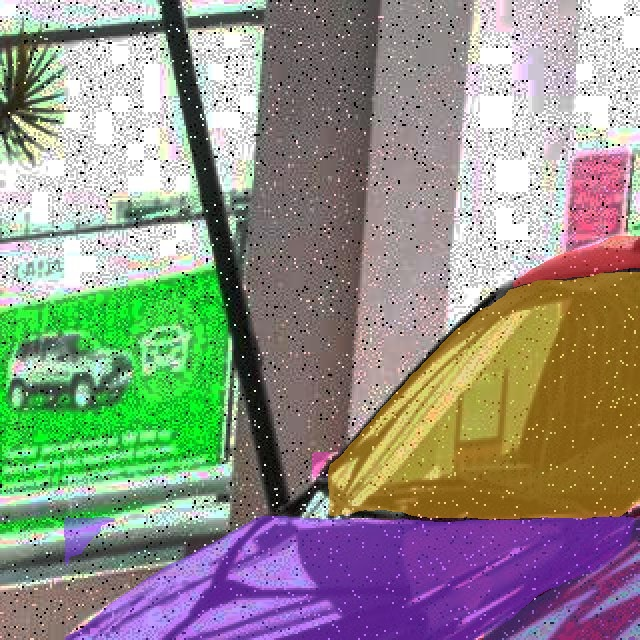

/content/runs/segment/predict3/101_png_jpg.rf.6c9f119825cdc959b96a6736d4469fb8.jpg


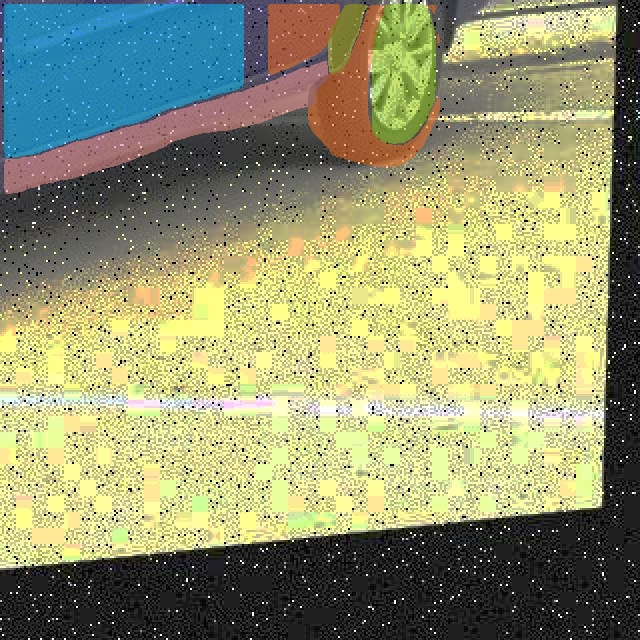

/content/runs/segment/predict3/100_png_jpg.rf.4ad92e1ddf9844ff11b3576fbe6ef59f.jpg


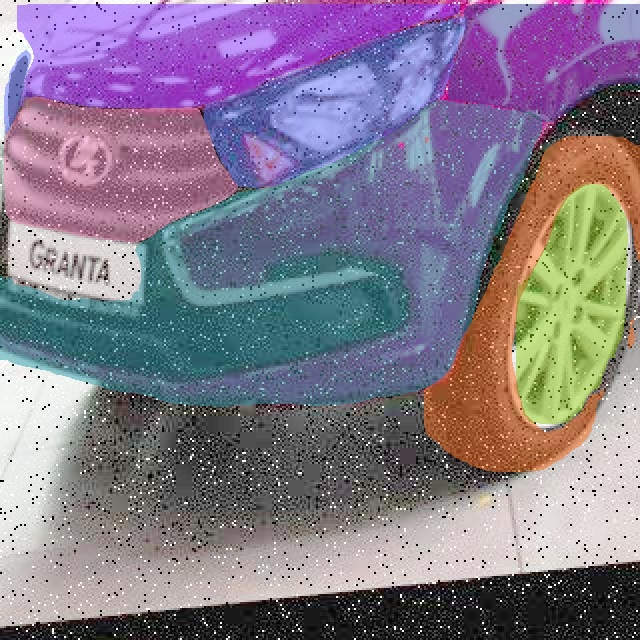

/content/runs/segment/predict3/101_png_jpg.rf.069277ea2d83072e5e4eb144a04889ab.jpg


In [39]:
for imageName in glob.glob(f'{HOME}/runs/segment/predict3/*.jpg'):
    display(Image(filename=imageName, width=800))
    print(imageName)

In [40]:
%cd {HOME}
!yolo task=segment mode=predict model={HOME}/runs/segment/train2/weights/best.pt conf=0.25 source={dataset.location}/test/images save=True exist_ok=true #boxes=false show_labels=true show_conf=true


/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11788888 parameters, 0 gradients, 42.5 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.0eafcc35c8253a877822a98fd15a4807.jpg: 640x640 1 car_rims_1, 1 front_bumper_1, 1 front_fender_1, 2 front_light_1s, 1 hood_1, 1 mudguard_1, 1 radiator_1, 2 tire_1s, 21.0ms
image 2/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.4ad92e1ddf9844ff11b3576fbe6ef59f.jpg: 640x640 1 back_door_1, 2 back_pillar_with_back_fender_1s, 1 car_rims_1, 1 front_door_1, 1 side_steps_1, 1 tire_1, 21.0ms
image 3/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.717769fa757d34d9d573943d391f93b9.jpg: 640x640 1 antenna_1, 2 front_fender_1s, 1 front_light_1, 1 hood_1, 1 roof_1, 1 windowark_1, 21.1ms
image 4/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.9340cb2e6f9

# Смотрим как отработала с рамками и вероятностями

In [12]:
%cd {HOME}

!yolo task=segment mode=predict model={HOME}/runs/segment/train2/weights/best.pt conf=0.25 source={dataset.location}/test/images save=True exist_ok=true #boxes=false show_labels=true show_conf=true

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11788888 parameters, 0 gradients, 42.5 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.0eafcc35c8253a877822a98fd15a4807.jpg: 640x640 1 car_rims_1, 1 front_bumper_1, 1 front_fender_1, 2 front_light_1s, 1 hood_1, 1 mudguard_1, 1 radiator_1, 2 tire_1s, 21.1ms
image 2/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.4ad92e1ddf9844ff11b3576fbe6ef59f.jpg: 640x640 1 back_door_1, 2 back_pillar_with_back_fender_1s, 1 car_rims_1, 1 front_door_1, 1 side_steps_1, 1 tire_1, 21.0ms
image 3/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.717769fa757d34d9d573943d391f93b9.jpg: 640x640 1 antenna_1, 2 front_fender_1s, 1 front_light_1, 1 hood_1, 1 roof_1, 1 windowark_1, 21.0ms
image 4/20 /content/datasets/cars_body_parts-3/test/images/100_png_jpg.rf.9340cb2e6f9

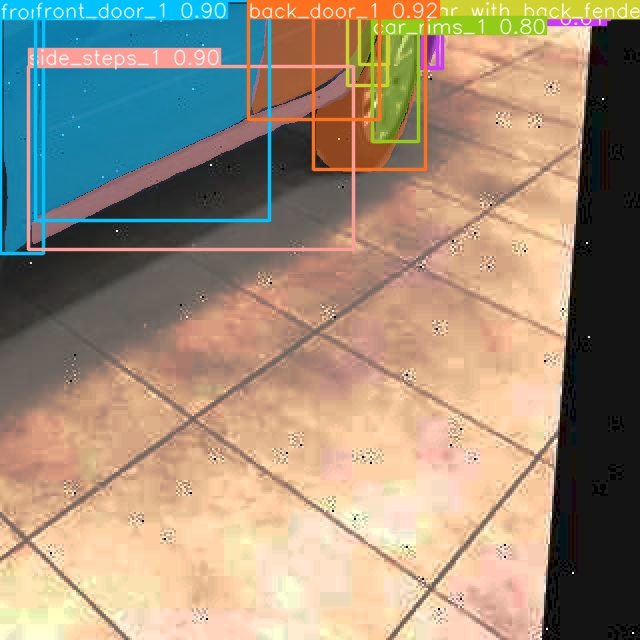

/content/runs/segment/predict/107_png_jpg.rf.f081d6e853c2cd1d7a2031a07dc4ccaf.jpg


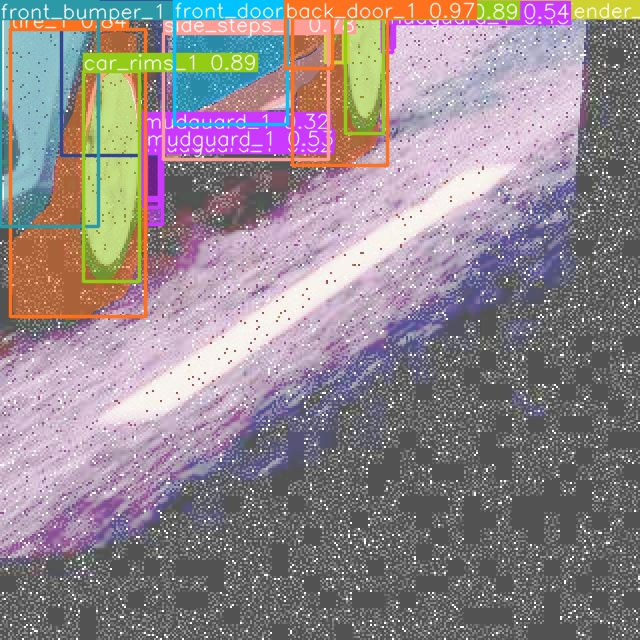

/content/runs/segment/predict/631_png_jpg.rf.ec38ad2fc8f42ba927b6d9ad0c55bb62.jpg


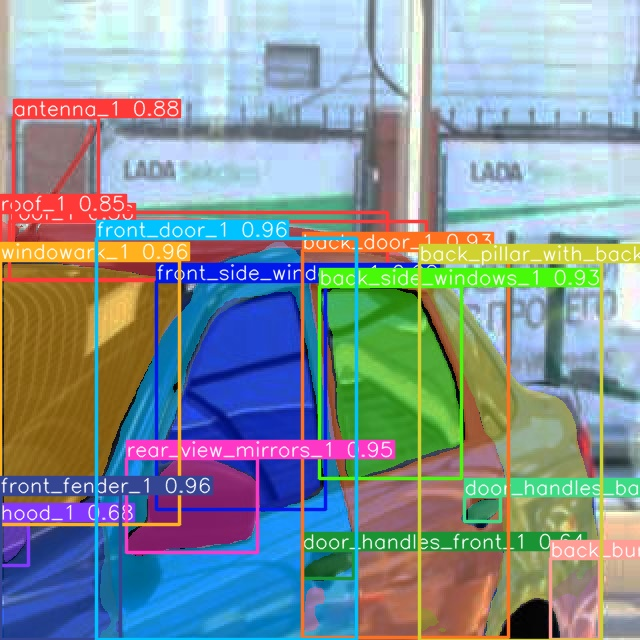

/content/runs/segment/predict/105_png_jpg.rf.636bc47b317f85cde1031350cbe87e2f.jpg


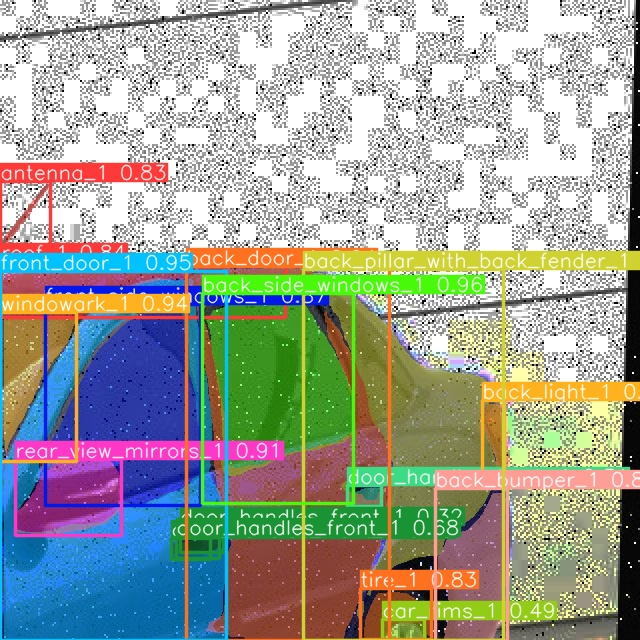

/content/runs/segment/predict/100_png_jpg.rf.9340cb2e6f9e1001e937267adf6c2a4a.jpg


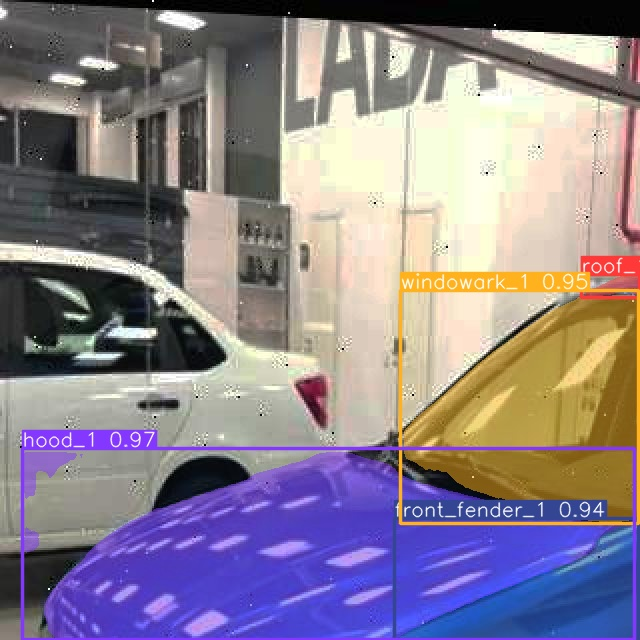

/content/runs/segment/predict/107_png_jpg.rf.b8fbc3e4a81da35a316eade850fed3d2.jpg


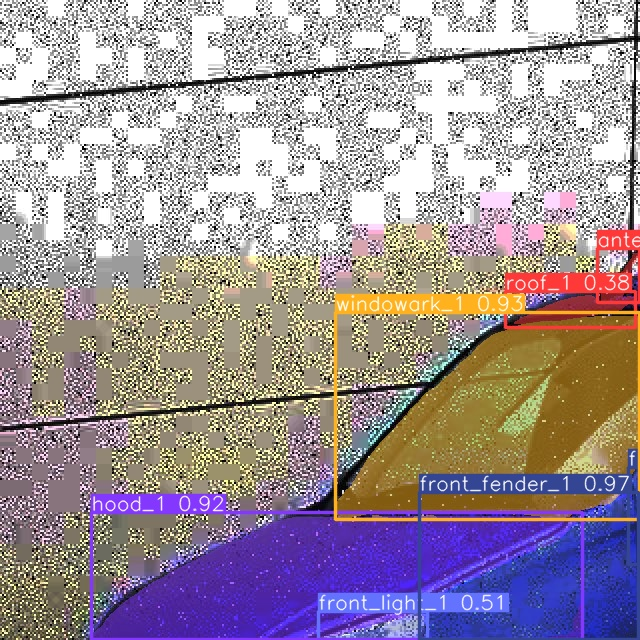

/content/runs/segment/predict/100_png_jpg.rf.717769fa757d34d9d573943d391f93b9.jpg


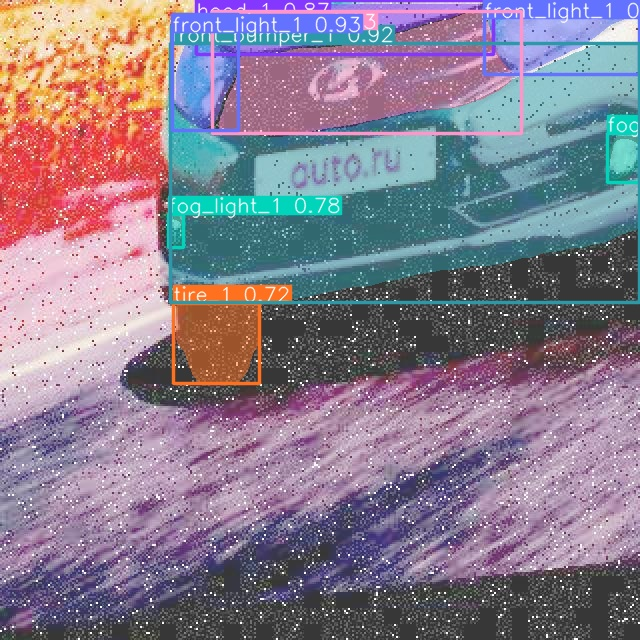

/content/runs/segment/predict/631_png_jpg.rf.14feee61d3c2b8db5627d2e8dcef31b5.jpg


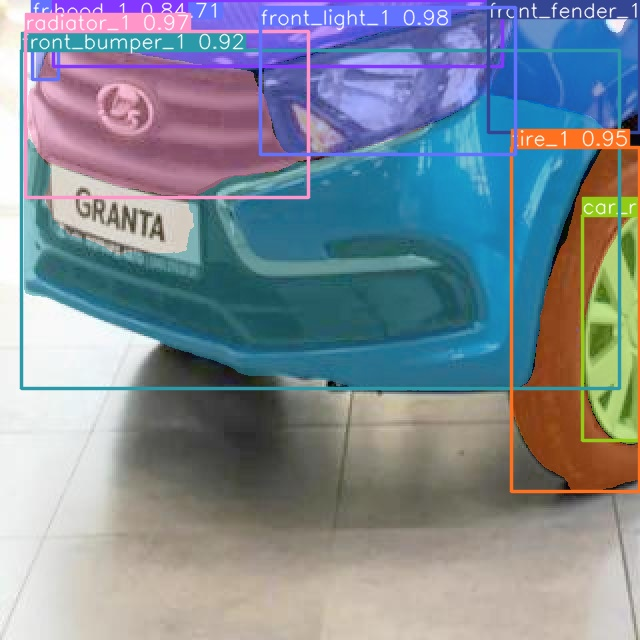

/content/runs/segment/predict/105_png_jpg.rf.35f0c9ab2810c9e543f76eee6a449f82.jpg


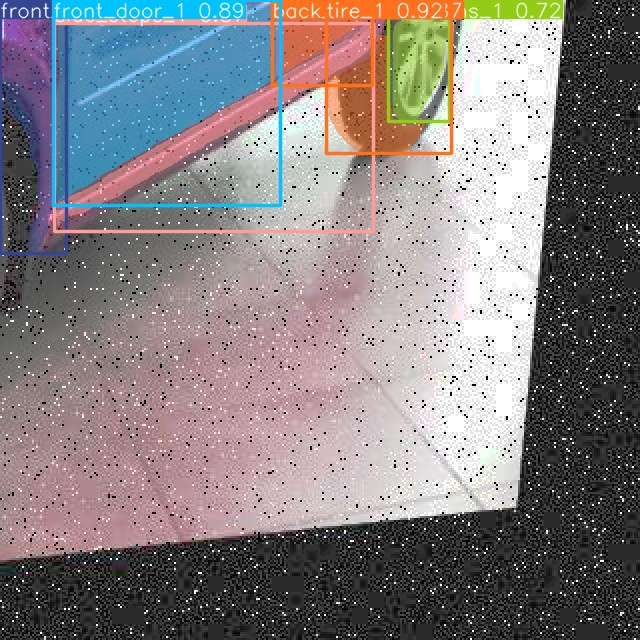

/content/runs/segment/predict/101_png_jpg.rf.1e0365e81bf956570dff206877257ae9.jpg


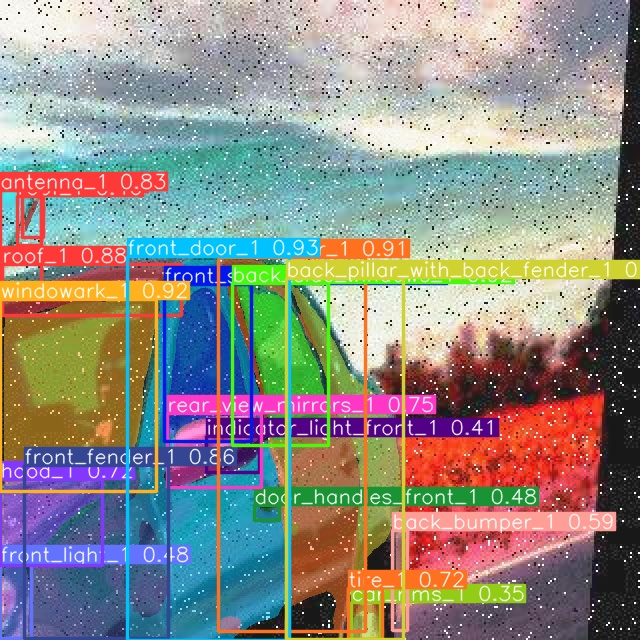

/content/runs/segment/predict/631_png_jpg.rf.8329fc1ce5e4fec8eed0f9f8b419de63.jpg


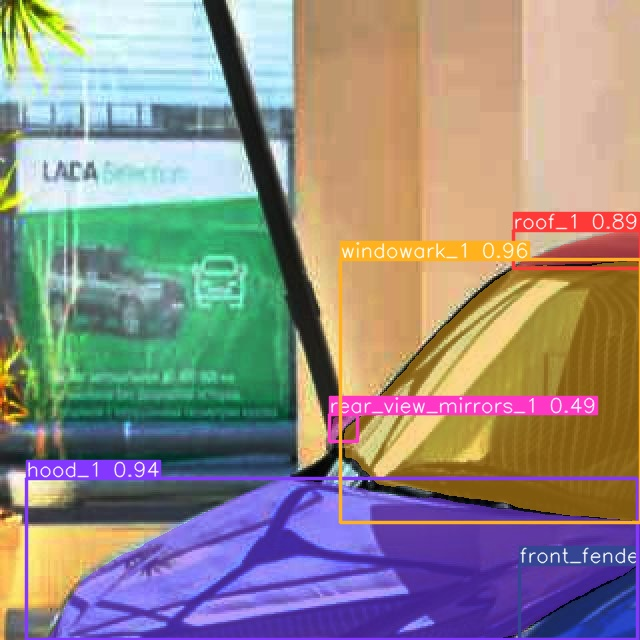

/content/runs/segment/predict/105_png_jpg.rf.d8f5fbbb48804190177cd83bb3bc5a5f.jpg


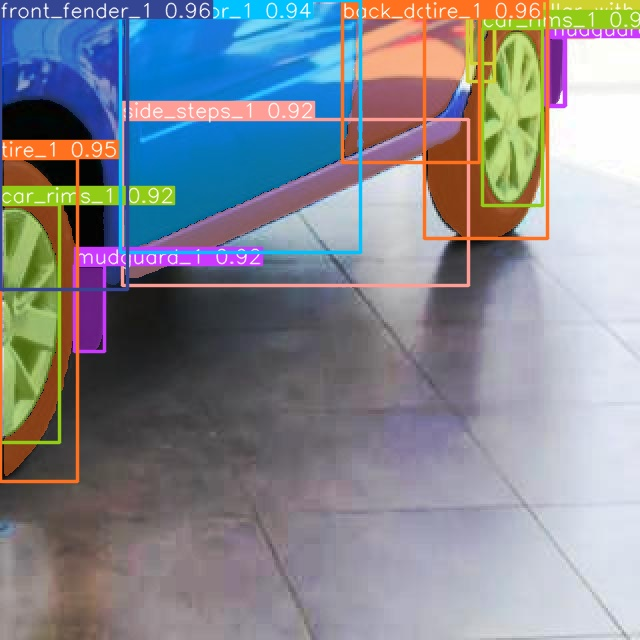

/content/runs/segment/predict/105_png_jpg.rf.bf96d3d0fcad6e1943299028a7fd4c53.jpg


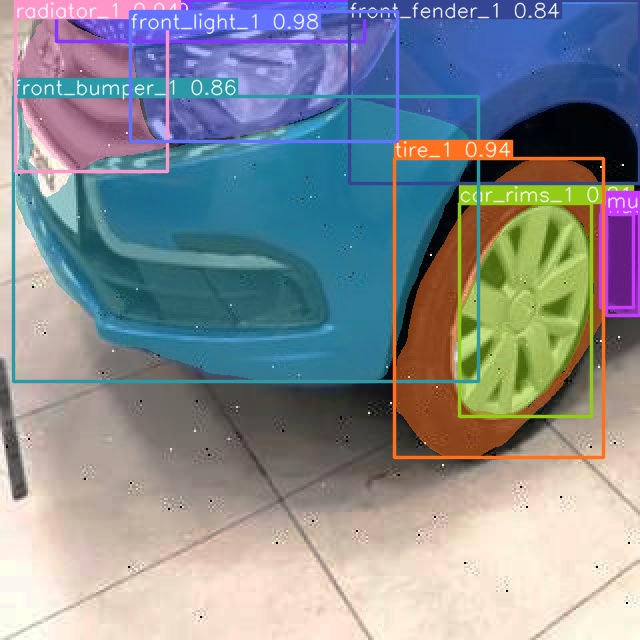

/content/runs/segment/predict/107_png_jpg.rf.acbad7e6e1f894d1f438211eb84e4279.jpg


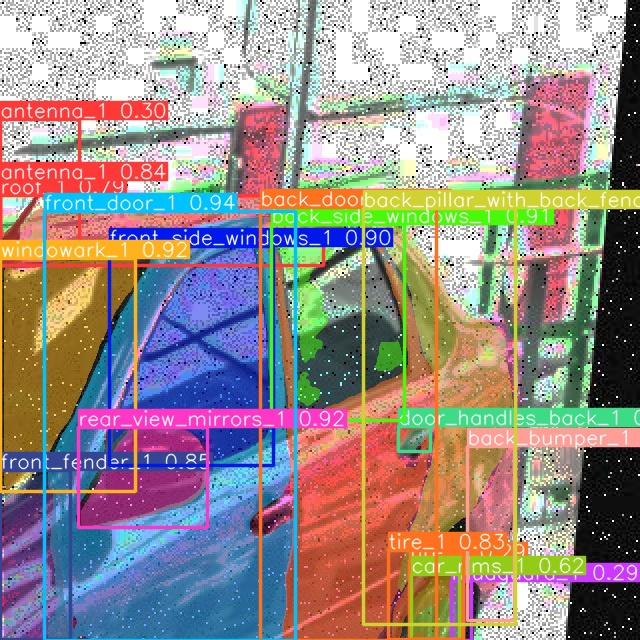

/content/runs/segment/predict/101_png_jpg.rf.60b015b42aad6e032f6d9579ed66cf69.jpg


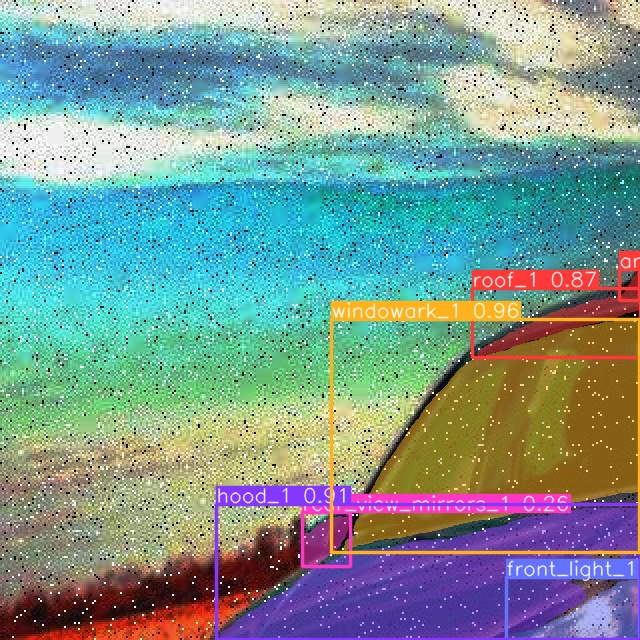

/content/runs/segment/predict/631_png_jpg.rf.3e554104de97e8478e298495b8101520.jpg


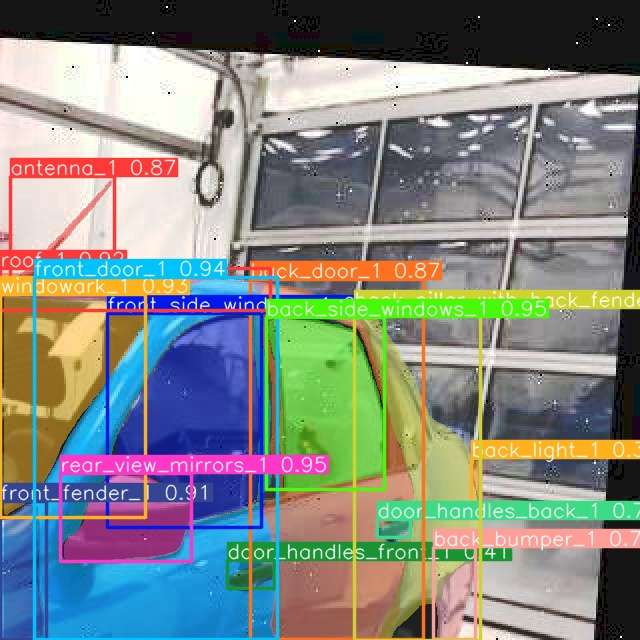

/content/runs/segment/predict/107_png_jpg.rf.e547a201e6971528d612074b94beb62d.jpg


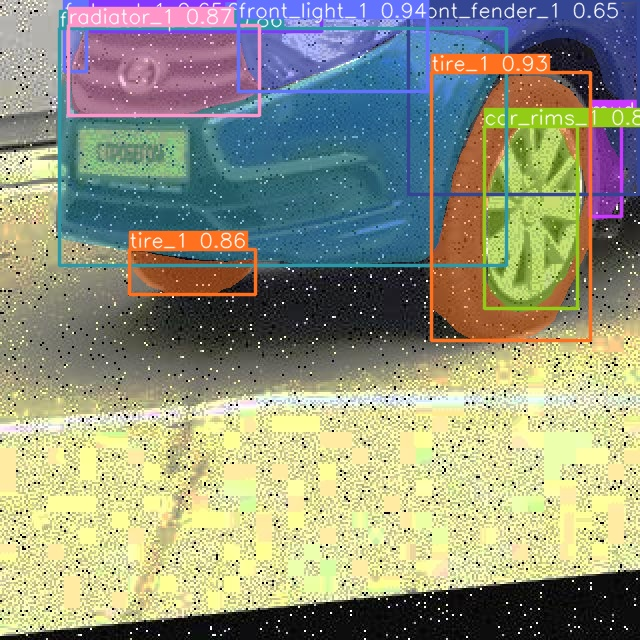

/content/runs/segment/predict/100_png_jpg.rf.0eafcc35c8253a877822a98fd15a4807.jpg


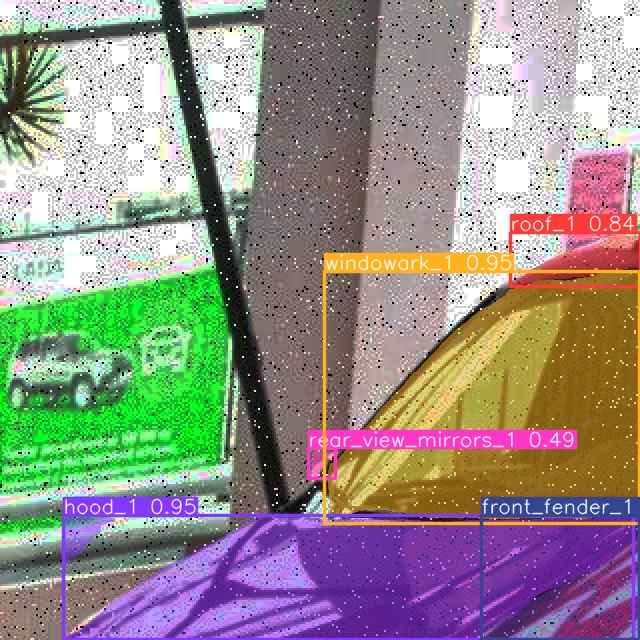

/content/runs/segment/predict/101_png_jpg.rf.6c9f119825cdc959b96a6736d4469fb8.jpg


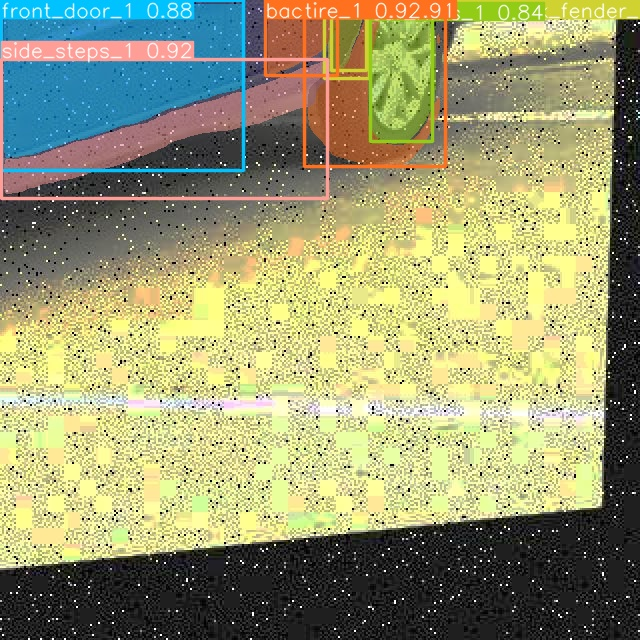

/content/runs/segment/predict/100_png_jpg.rf.4ad92e1ddf9844ff11b3576fbe6ef59f.jpg


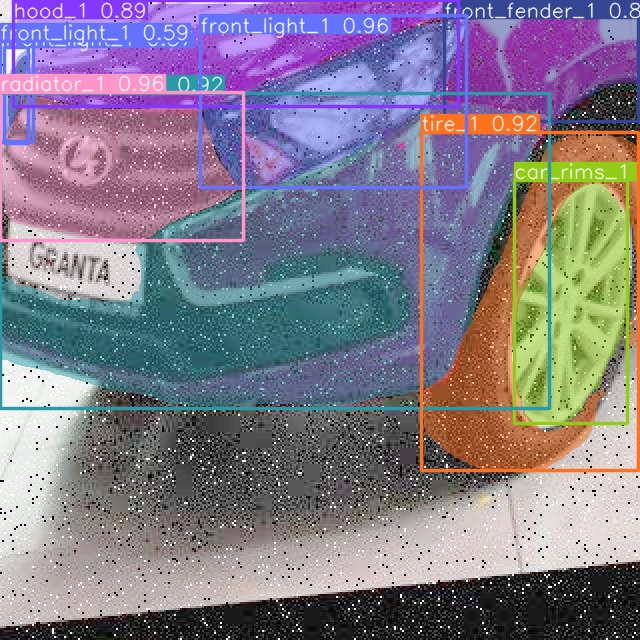

/content/runs/segment/predict/101_png_jpg.rf.069277ea2d83072e5e4eb144a04889ab.jpg


In [ ]:
import glob

for imageName in glob.glob(f'{HOME}/runs/segment/predict/*.jpg'): #assuming JPG
    display(Image(filename=imageName, width=800))
    print(imageName)

# Проверяем на неразмеченных данных.

# Проверяем на виде, на котором шло обучение.

In [49]:
%cd {HOME}

!yolo task=segment mode=predict model=/content/runs/segment/train2/weights/best.pt conf=0.25 source=/content/test_image save=True # exist_ok=true boxes=false

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11788888 parameters, 0 gradients, 42.5 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/8 /content/test_image/539.png: 384x640 1 back_door_1, 1 back_pillar_with_back_fender_1, 1 back_side_windows_1, 2 car_rims_1s, 1 front_bumper_1, 1 front_door_1, 1 front_fender_1, 2 front_light_1s, 1 front_side_windows_1, 2 hood_1s, 1 mudguard_1, 1 radiator_1, 1 rear_view_mirrors_1, 1 roof_1, 1 side_steps_1, 2 tire_1s, 118.5ms
image 2/8 /content/test_image/540.png: 384x640 1 back_door_1, 1 back_pillar_with_back_fender_1, 1 back_side_windows_1, 2 car_rims_1s, 2 door_handles_back_1s, 1 front_bumper_1, 1 front_door_1, 1 front_fender_1, 2 front_light_1s, 1 front_side_windows_1, 1 hood_1, 1 mudguard_1, 1 roof_1, 1 side_steps_1, 3 tire_1s, 1 windowark_1, 13.8ms
image 3/8 /content/test_image/541.png: 384x640 1 back_door_1, 1 back_pillar_with_back_fender_1, 1 back_

In [50]:
HOME = os.getcwd()
import glob
import matplotlib.pyplot as plt
import cv2

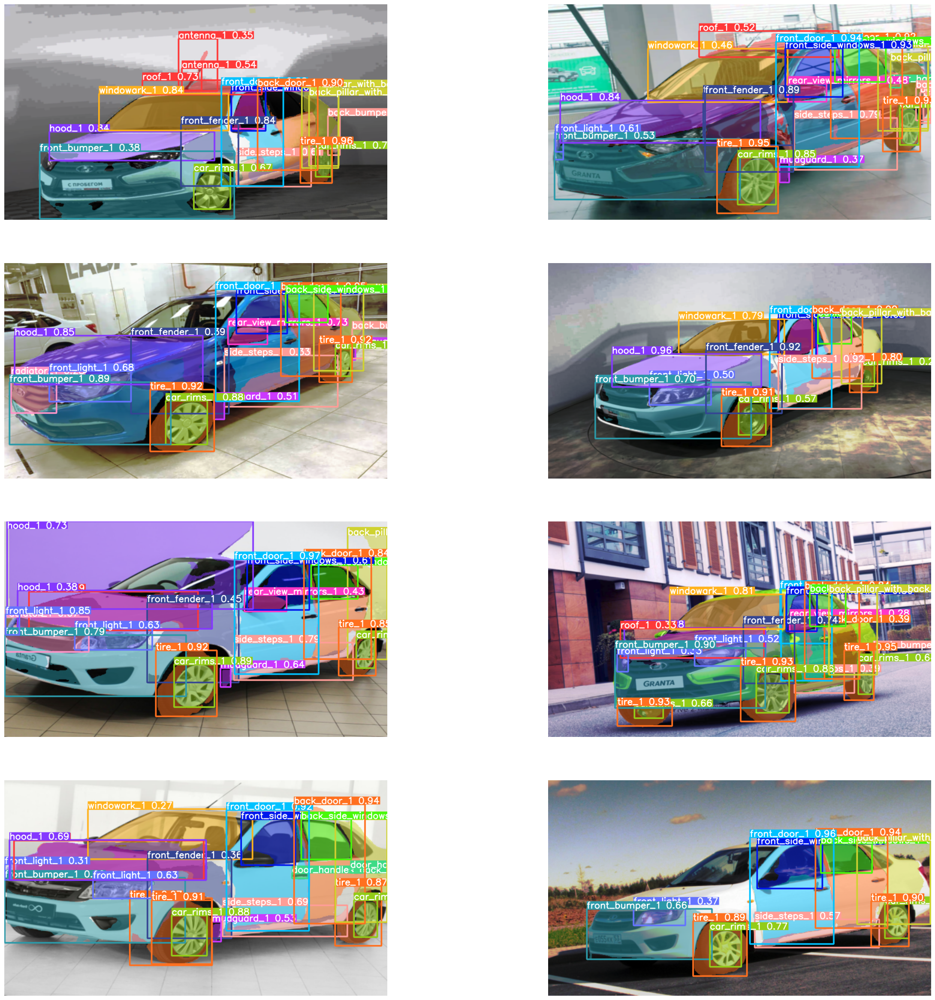

In [70]:
pic = f'{HOME}/runs/segment/predict5'
pictures = os.listdir(pic)
pic_box = plt.figure(figsize=(30,30))


for i, picture in enumerate(pictures):
    picture = cv2.imread(pic+ '/' + picture)
    picture = cv2.cvtColor(picture, cv2.COLOR_BGR2RGB)
    pic_box.add_subplot(4,2,i+1)
    plt.imshow(picture)
    plt.axis('off')

plt.show()

# Проверим на разных видах.

In [72]:
%cd {HOME}

!yolo task=segment mode=predict model=/content/runs/segment/train2/weights/best.pt conf=0.25 source=/content/test_image_randome save=True # exist_ok=true boxes=false

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11788888 parameters, 0 gradients, 42.5 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/6 /content/test_image_randome/1069.png: 384x640 3 antenna_1s, 3 back_door_1s, 2 back_side_windows_1s, 1 car_rims_1, 1 front_bumper_1, 1 front_door_1, 1 front_side_windows_1, 1 rear_view_mirrors_1, 1 side_steps_1, 2 tire_1s, 116.5ms
image 2/6 /content/test_image_randome/15.png: 384x640 2 front_light_1s, 1 hood_1, 2 rear_view_mirrors_1s, 2 tire_1s, 13.9ms
image 3/6 /content/test_image_randome/193.png: 384x640 1 back_bumper_1, 1 back_door_1, 1 back_pillar_with_back_fender_1, 1 back_side_windows_1, 1 car_rims_1, 3 door_handles_back_1s, 1 front_bumper_1, 1 front_door_1, 1 front_fender_1, 1 front_light_1, 1 front_side_windows_1, 1 mudguard_1, 1 side_steps_1, 3 tire_1s, 13.8ms
image 4/6 /content/test_image_randome/238.png: 384x640 2 back_door_1s, 1 back_side_win

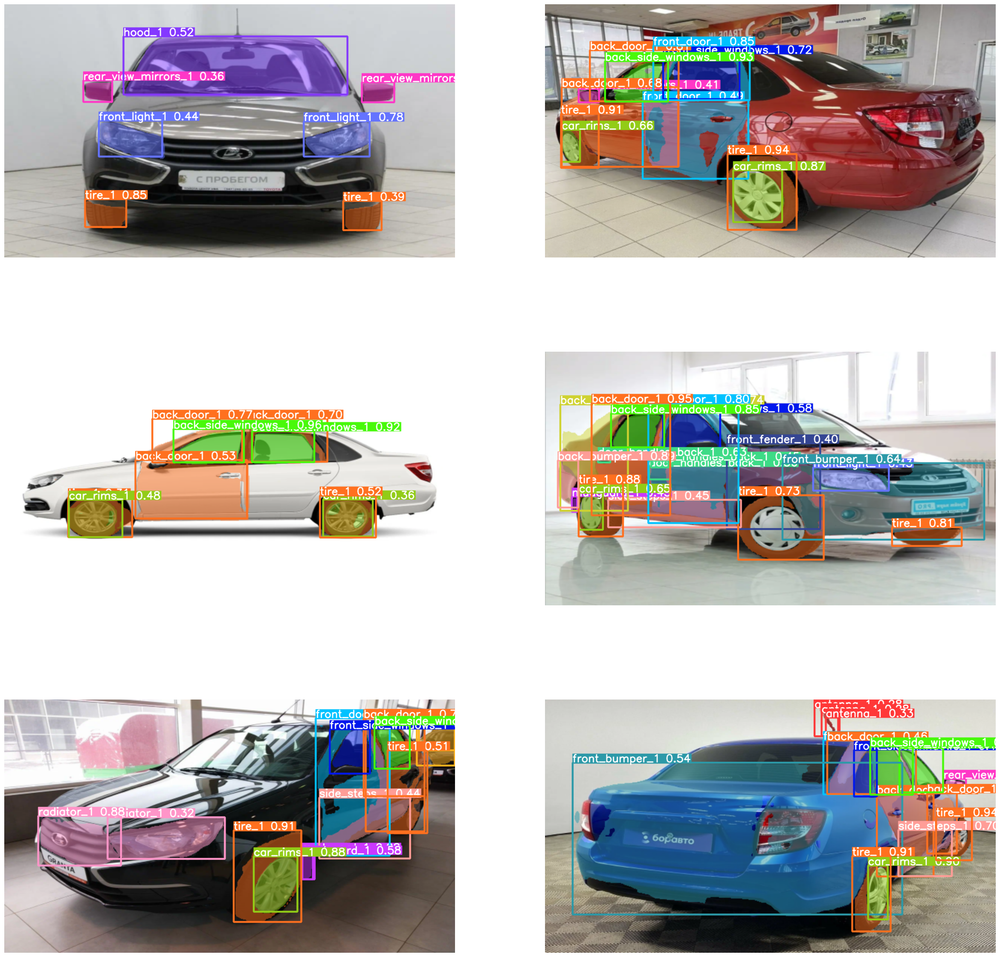

In [74]:
pic = f'{HOME}/runs/segment/predict6'
pictures = os.listdir(pic)
pic_box = plt.figure(figsize=(30,30))


for i, picture in enumerate(pictures):
    picture = cv2.imread(pic+ '/' + picture)
    picture = cv2.cvtColor(picture, cv2.COLOR_BGR2RGB)
    pic_box.add_subplot(3,2,i+1)
    plt.imshow(picture)
    plt.axis('off')

plt.show()

# Вывод:

По результам мы видим, что способность нужно расширять базу данных, делать разметку по всем классам (в представленной работе только один вид).

Так же стоит обратить внимание, чтобы в базе данных была только "одна" модель данного автомобиля, а тут представленно две модификации, из-за этого иногда "indicator_light_front" показывает на зеркало (на одной модификации повторитель поворотника не зеркале заднего вида).

Колеса и диски почти везде отработаны правильно, из-за большого кол-ва этих экземпляров.

Советы для улучшения:
1. Увеличить базу размеченных данных.
2. Кол-во эпох не стоит выбирать сильно много, улучшений особо не будет, а время затрачивается много, выбрать оптимальное кол-во.
3. Добавить в базу все 8 видов.
4. Использовать в разметке только одну модификацию машины.